# Load packages and data

In [1]:
# Loading the required packages to run this notebook
from src.visualisation.VisualiseTrajectories import VisualiseTrajectories
from pathlib import Path
import pandas as pd
import numpy as np

# Setup the correct foldure structure
project_dir = Path().resolve().parents[1]
processed_data_dir = project_dir / "data" / "processed"

# Define the regions to look into
fig_size = (10, 10)
Denmark = VisualiseTrajectories(region="Denmark", save_figures=True, plot_figures=True, fig_size=fig_size, zoom=6)
Skagen = VisualiseTrajectories(region="Skagen", save_figures=True, plot_figures=True, fig_size=fig_size, zoom=7)
Bornholm = VisualiseTrajectories(region="Bornholm", save_figures=True, plot_figures=True, fig_size=fig_size, zoom=8)
hue_order = ["Cargo", "Tanker", "Fishing"]

In [2]:
# Read in the processed trajectories for exploratory analysis
summary_file = "RegionAll_01042019_31032020_FishCargTank_600_315569220_60_trajectories_summary.csv"
df = pd.read_csv(processed_data_dir / summary_file)
df["DateTime"] = pd.to_datetime(df["DateTime"])
df.sample(n=3)

,MMSI,ShipType,TrackLength,MeanSpeed,DateTime,DateTimeStart,DateTimeEnd,StartLat,EndLat,StartLon,EndLon
114358,245573000,Tanker,1301,9.945746,2019-07-26 00:58:36.000000000,2019-07-25 14:08:36.000000000,2019-07-26 11:48:36.000000000,54.524929,57.542333,10.268405,11.676500
91175,236652000,Tanker,81,3.495064,2019-08-12 03:15:24.999999744,2019-08-12 02:35:25.000000000,2019-08-12 03:55:25.000000000,55.747235,55.676092,12.662973,12.633526
17924,211363300,Fishing,93,0.016513,2019-07-22 04:15:38.000000000,2019-07-22 03:29:38.000000000,2019-07-22 05:01:38.000000000,54.758983,54.758926,8.294800,8.295240


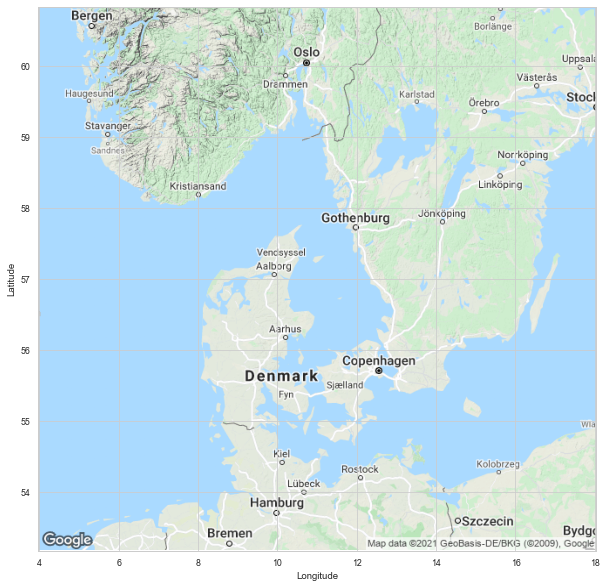

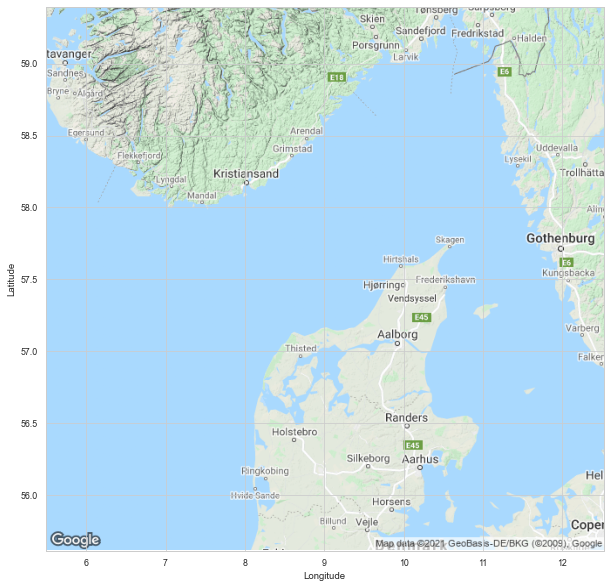

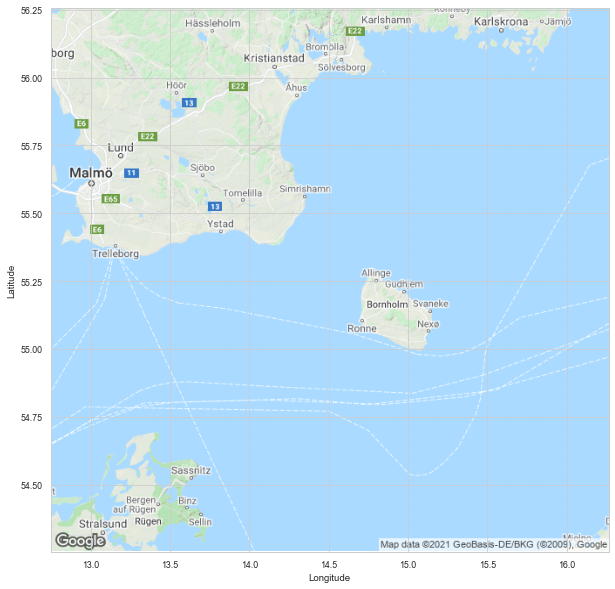

In [3]:
# Load and show the regions as Google Maps images
_, _, _ = Denmark.read_visualise_static_map()
_, _, _ = Skagen.read_visualise_static_map()
_, _, _ = Bornholm.read_visualise_static_map()

# Start Location-Based Exploration

In [4]:
print(np.shape(df))
lat_lon_names = ["StartLat", "StartLon"]

# Take out points outside the min/max lon/lat interval - Denmark
df_start_Denmark = Denmark.remove_points_outside_ROI(df, lat_lon_names)
print(np.shape(df_start_Denmark))
    
# Take out points outside the min/max lon/lat interval - Skagen
df_start_Skagen = Skagen.remove_points_outside_ROI(df, lat_lon_names)
print(np.shape(df_start_Skagen))

# Take out points outside the min/max lon/lat interval - Bornholm
df_start_Bornholm = Bornholm.remove_points_outside_ROI(df, lat_lon_names)
print(np.shape(df_start_Bornholm))

(272589, 11)
(256358, 11)
(99039, 11)
(34037, 11)


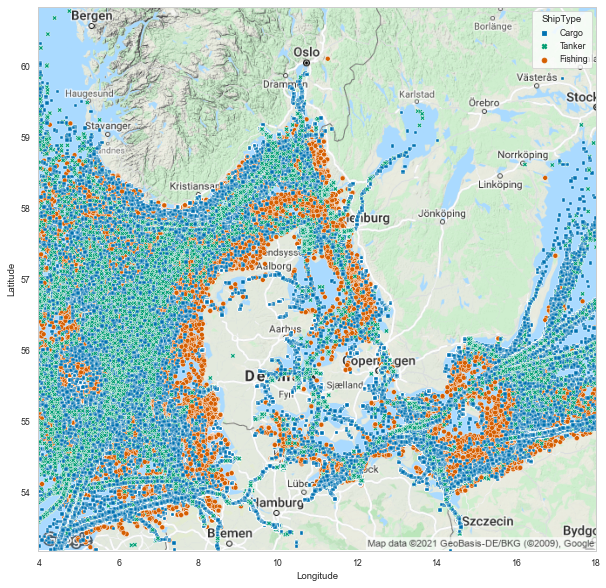

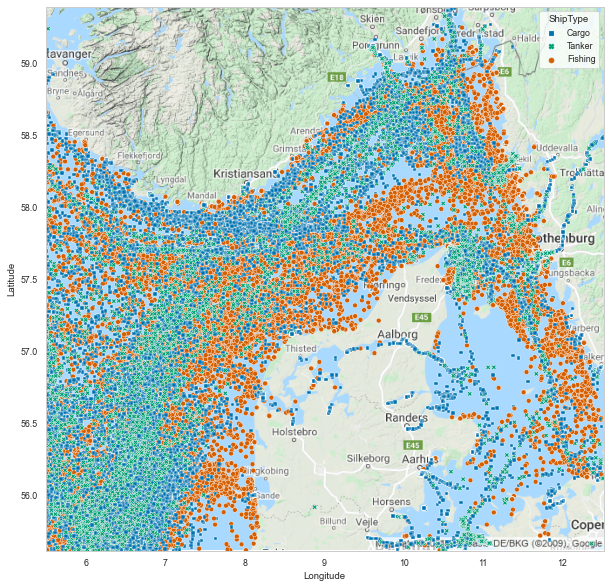

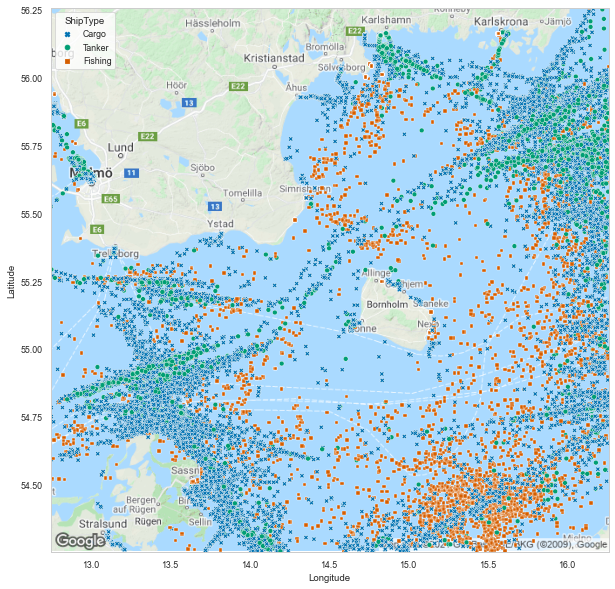

In [5]:
# Plot all the trajectory starting locations on the static map
type = "Scatter"
x = "StartLon"
y = "StartLat"
hue = "ShipType"
Denmark.plot_points(df_start_Denmark, type=type, x=x, y=y, hue=hue, style=hue, hue_order=hue_order)
Skagen.plot_points(df_start_Skagen, type=type, x=x, y=y, hue=hue, style=hue, hue_order=hue_order)
Bornholm.plot_points(df_start_Bornholm, type=type, x=x, y=y, hue=hue, style=hue, hue_order=hue_order)

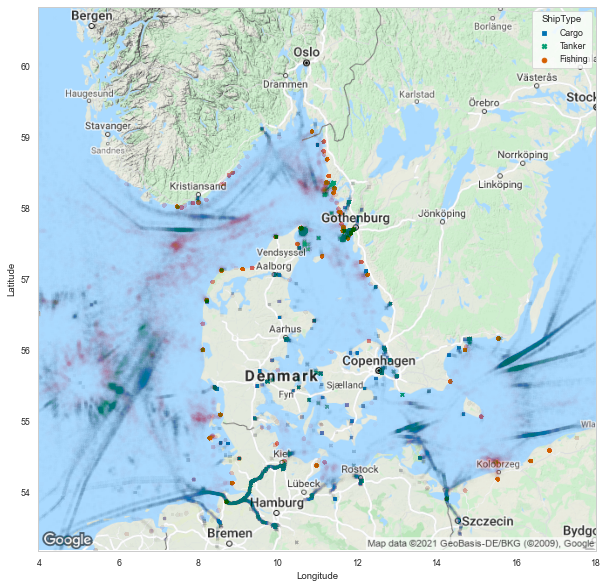

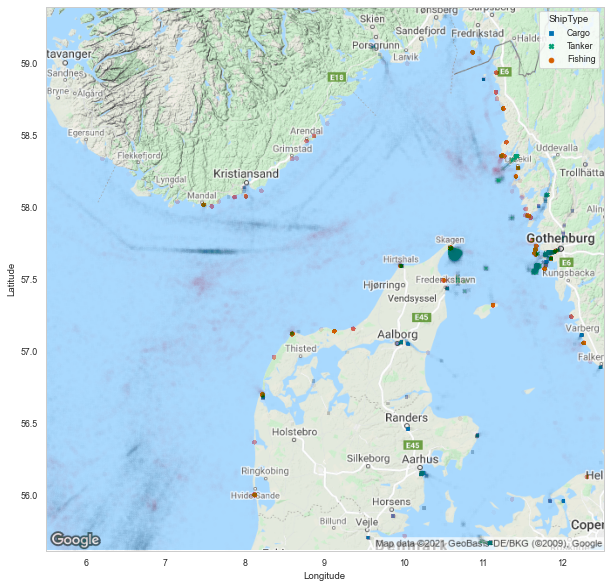

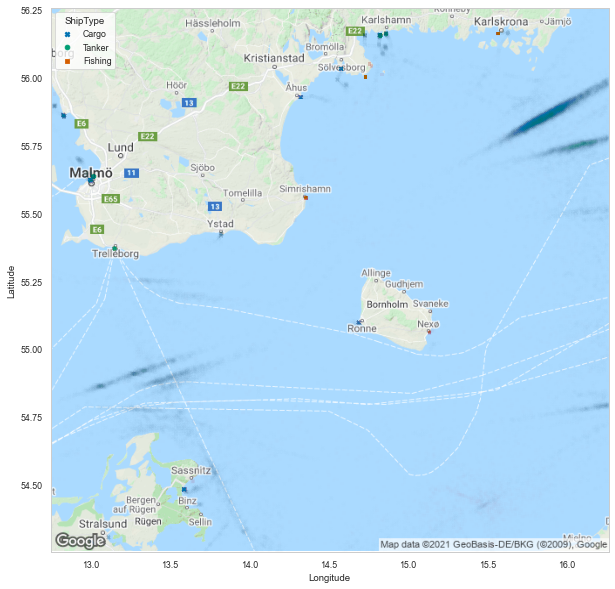

In [6]:
# Plot all the trajectory starting locations on the static map - Setting the proportional opacity of the points
file_name = "all_track_starting_locations_by_shipType_with_proportional_opacity"
alpha = 0.005
Denmark.plot_points(df_start_Denmark, type=type, x=x, y=y, hue=hue, style=hue,
                    hue_order=hue_order, alpha=alpha, file_name=file_name)
Skagen.plot_points(df_start_Skagen, type=type, x=x, y=y, hue=hue, style=hue,
                    hue_order=hue_order, alpha=alpha, file_name=file_name)
Bornholm.plot_points(df_start_Bornholm, type=type, x=x, y=y, hue=hue, style=hue,
                    hue_order=hue_order, alpha=alpha, file_name=file_name)

In [7]:
# Define data frames that focus on fishing vessels
df_start_fishing_Denmark = df_start_Denmark.loc[df_start_Denmark["ShipType"] == "Fishing"]
print(np.shape(df_start_fishing_Denmark))
df_start_fishing_Skagen = df_start_Skagen.loc[df_start_Skagen["ShipType"] == "Fishing"]
print(np.shape(df_start_fishing_Skagen))
df_start_fishing_Bornholm = df_start_Bornholm.loc[df_start_Bornholm["ShipType"] == "Fishing"]
print(np.shape(df_start_fishing_Bornholm))
print()

# Define data frames that focus on cargo and tanker vessels
df_start_cargo_tank_Denmark = df_start_Denmark.loc[df_start_Denmark["ShipType"] != "Fishing"]
print(np.shape(df_start_cargo_tank_Denmark))
df_start_cargo_tank_Skagen = df_start_Skagen.loc[df_start_Skagen["ShipType"] != "Fishing"]
print(np.shape(df_start_cargo_tank_Skagen))
df_start_cargo_tank_Bornholm = df_start_Bornholm.loc[df_start_Bornholm["ShipType"] != "Fishing"]
print(np.shape(df_start_cargo_tank_Bornholm))

(60533, 11)
(34918, 11)
(5662, 11)

(195825, 11)
(64121, 11)
(28375, 11)


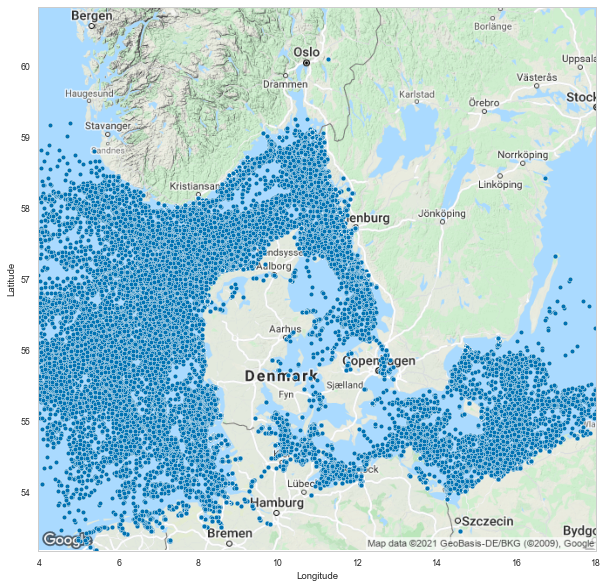

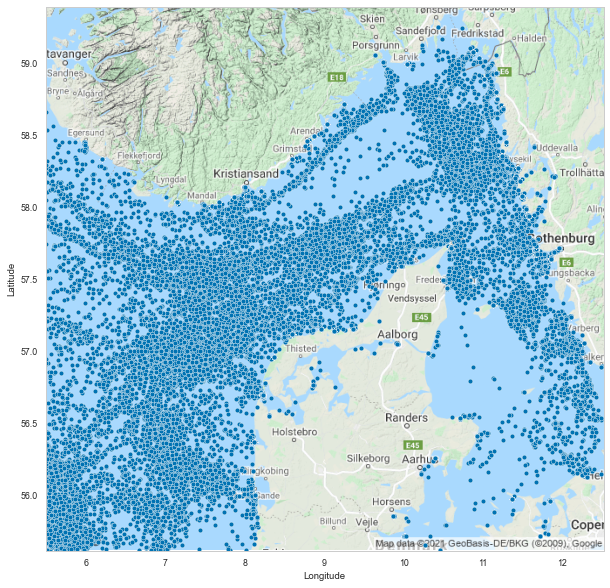

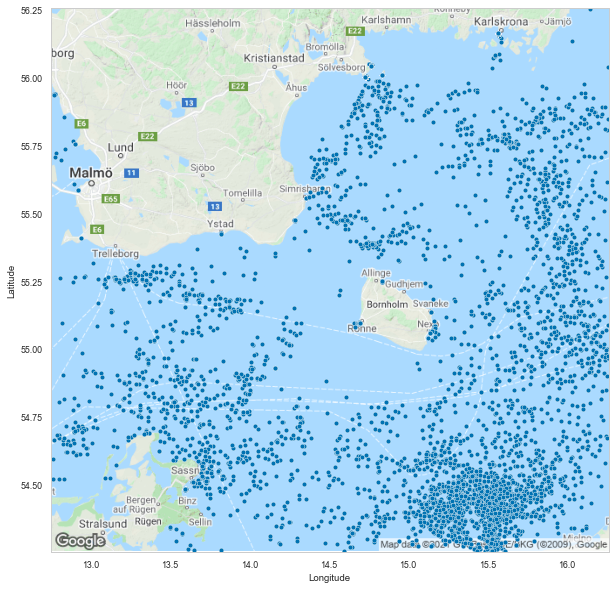

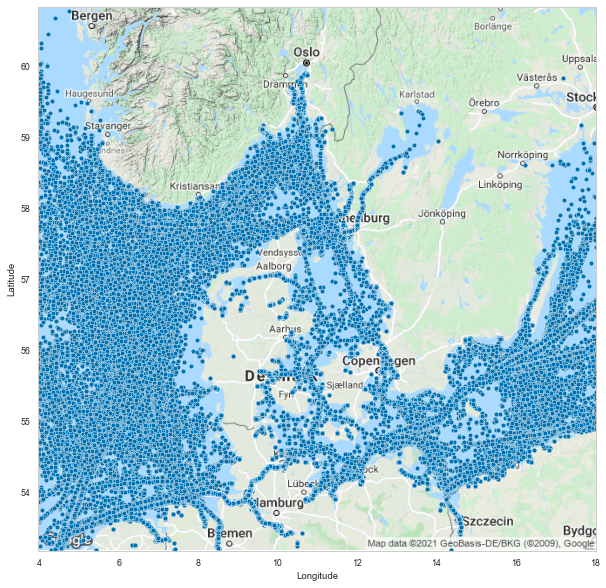

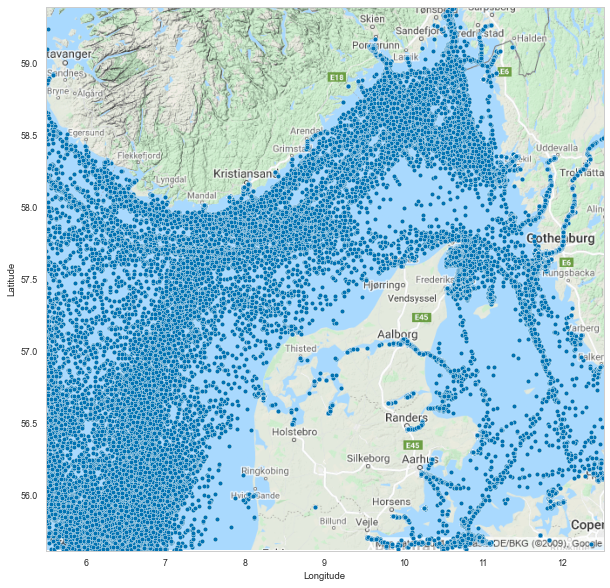

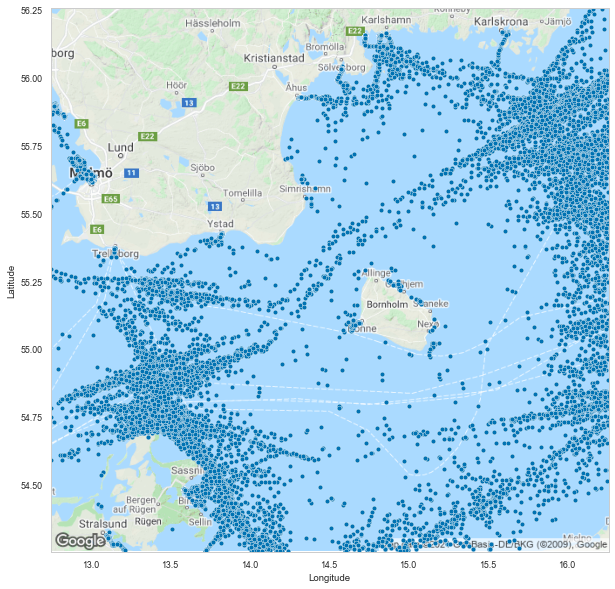

In [8]:
# Plot fishing trajectory starting locations on the static map
Denmark.plot_points(df_start_fishing_Denmark, type=type, x=x, y=y)
Skagen.plot_points(df_start_fishing_Skagen, type=type, x=x, y=y)
Bornholm.plot_points(df_start_fishing_Bornholm, type=type, x=x, y=y)

# Plot cargo and tanker vessel trajectory starting locations on the static map 
Denmark.plot_points(df_start_cargo_tank_Denmark, type=type, x=x, y=y)
Skagen.plot_points(df_start_cargo_tank_Skagen, type=type, x=x, y=y)
Bornholm.plot_points(df_start_cargo_tank_Bornholm, type=type, x=x, y=y)

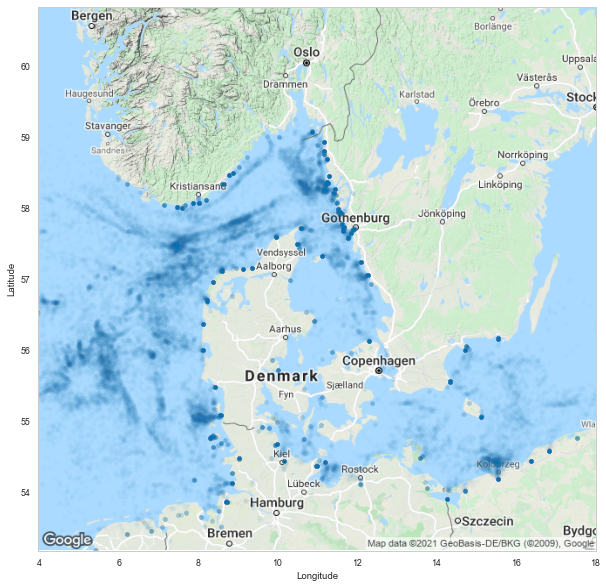

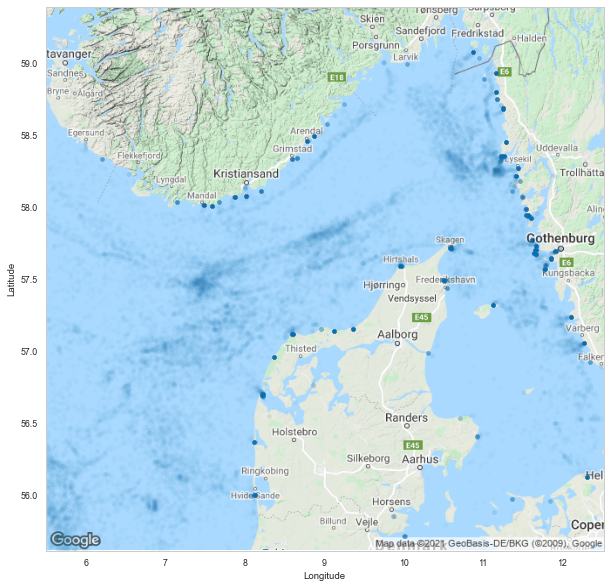

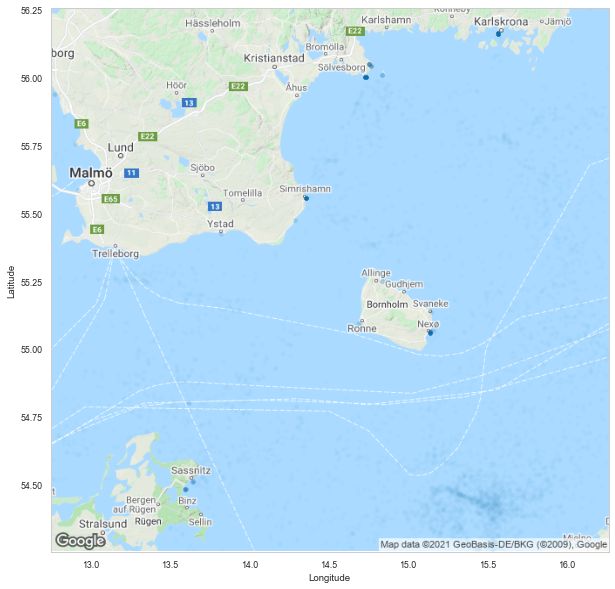

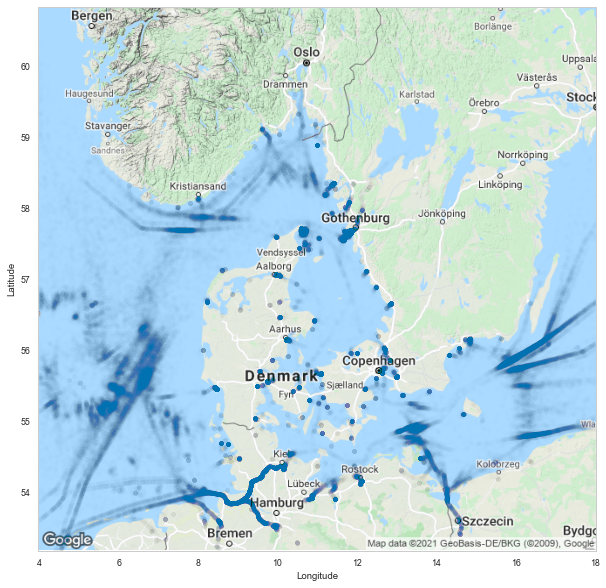

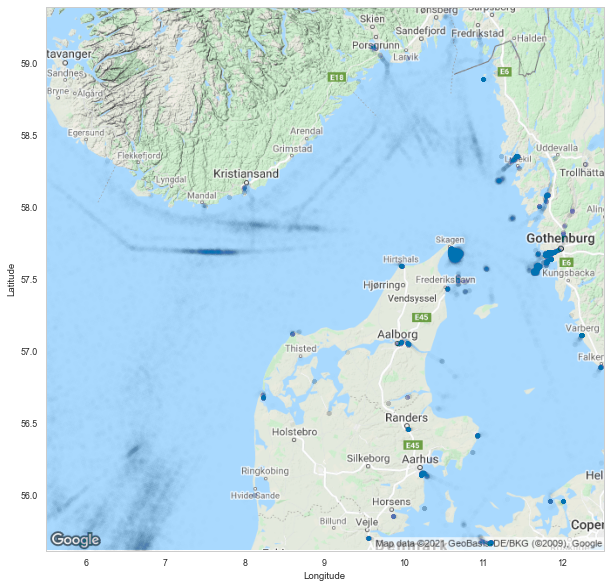

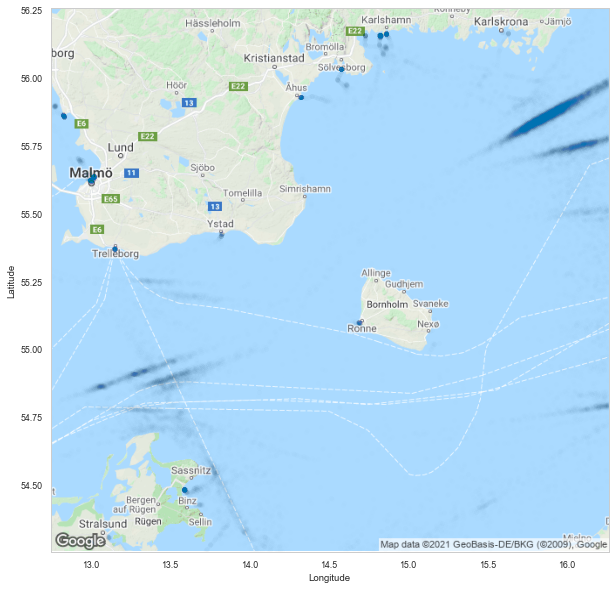

In [9]:
# Plot fishing trajectory starting locations on the static map - Setting the proportional opacity of the points
alpha = 0.02
Denmark.plot_points(df_start_fishing_Denmark, type=type, x=x, y=y, alpha=alpha)
Skagen.plot_points(df_start_fishing_Skagen, type=type, x=x, y=y, alpha=alpha)
Bornholm.plot_points(df_start_fishing_Bornholm, type=type, x=x, y=y, alpha=alpha)

# Plot tanker & cargo trajectory starting locations on the static map - Setting the proportional opacity of the points
alpha = 0.002
Denmark.plot_points(df_start_cargo_tank_Denmark, type=type, x=x, y=y, alpha=alpha)
Skagen.plot_points(df_start_cargo_tank_Skagen, type=type, x=x, y=y, alpha=alpha)
Bornholm.plot_points(df_start_cargo_tank_Bornholm, type=type, x=x, y=y, alpha=alpha)

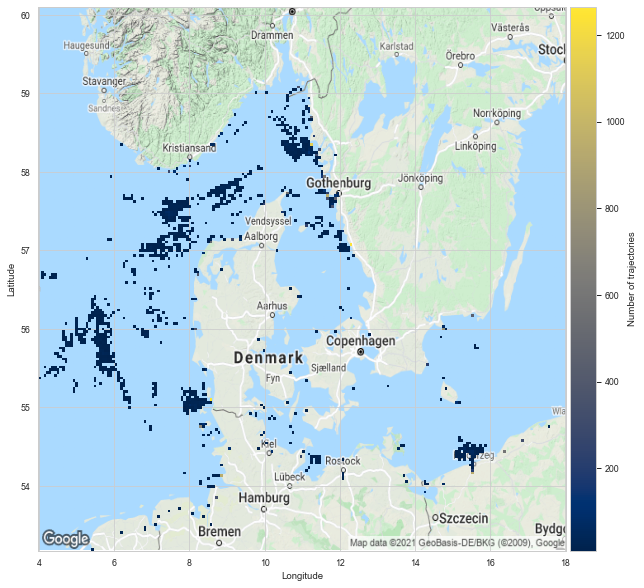

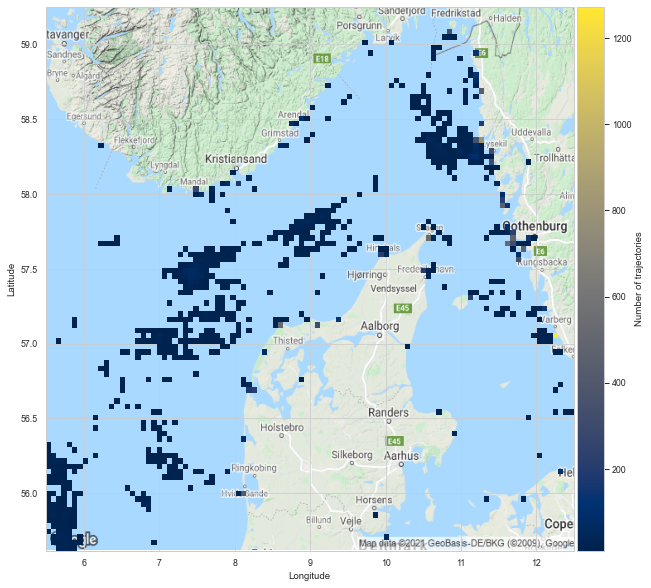

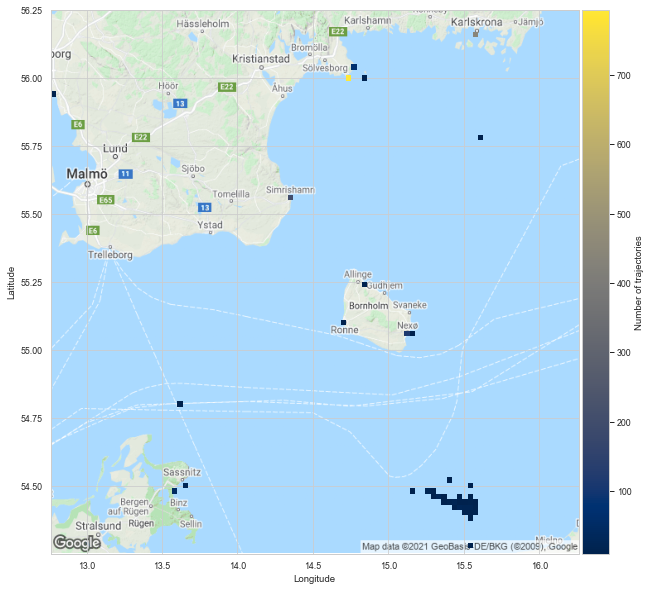

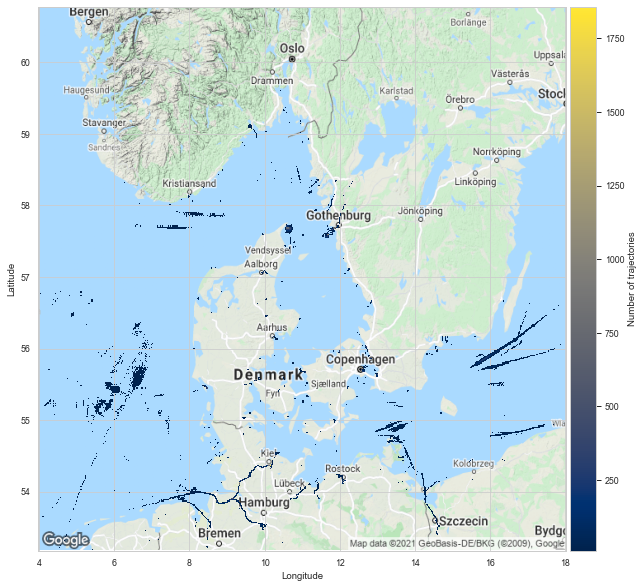

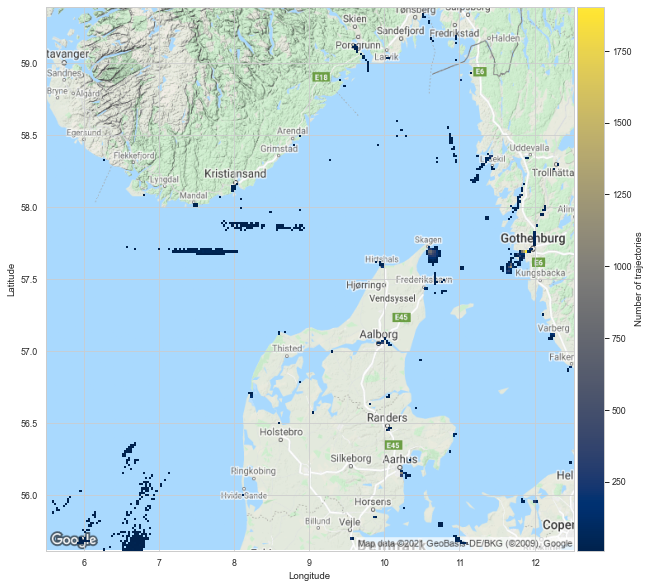

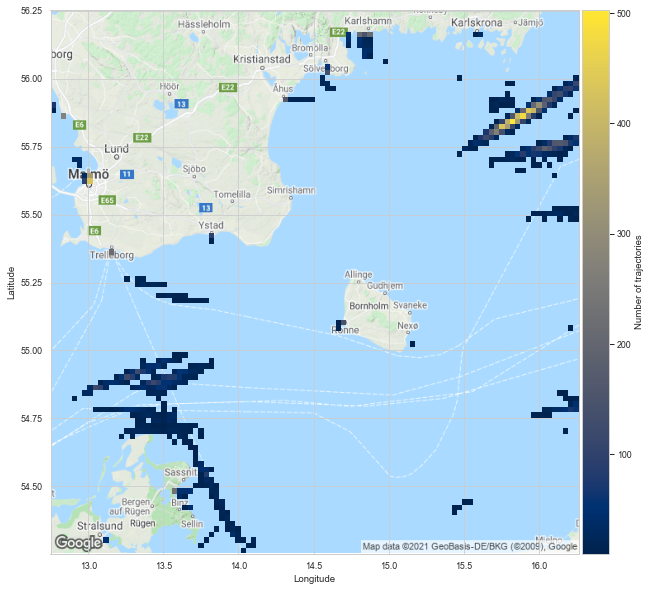

In [10]:
# Plot fishing trajectory starting locations on the static map - Heatmaps
type = "Hist"
cb_label = "Number of trajectories"
Denmark.plot_points(df_start_fishing_Denmark, type=type, x=x, y=y, bins=200, cb_label=cb_label)
Skagen.plot_points(df_start_fishing_Skagen, type=type, x=x, y=y, bins=100, cb_label=cb_label)
Bornholm.plot_points(df_start_fishing_Bornholm, type=type, x=x, y=y, bins=100, cb_label=cb_label)

# Plot tanker & cargo trajectory starting locations on the static map - Heatmap
Denmark.plot_points(df_start_cargo_tank_Denmark, type=type, x=x, y=y, bins=500, cb_label=cb_label)
Skagen.plot_points(df_start_cargo_tank_Skagen, type=type, x=x, y=y, bins=250, cb_label=cb_label)
Bornholm.plot_points(df_start_cargo_tank_Bornholm, type=type, x=x, y=y, bins=100, cb_label=cb_label)

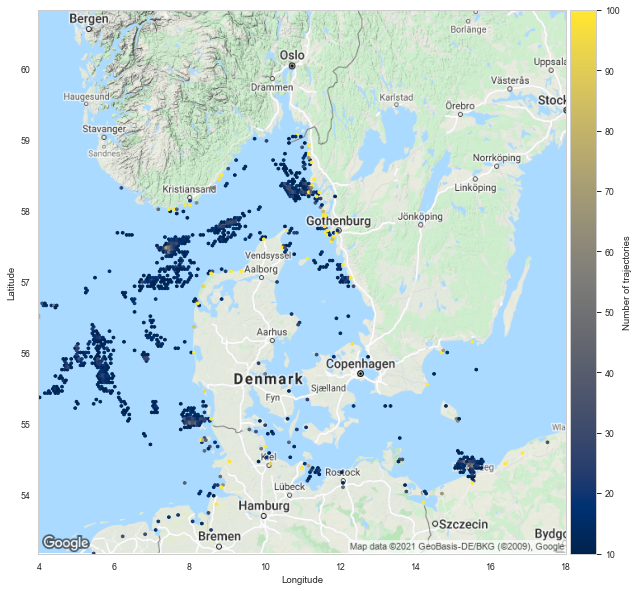

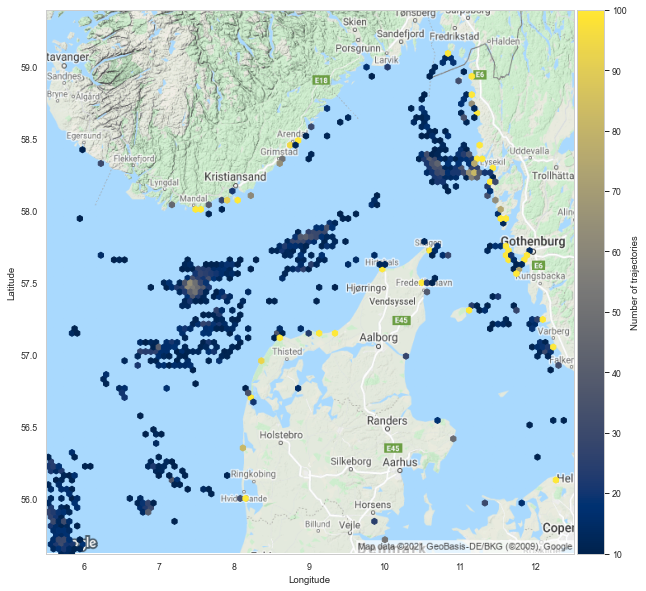

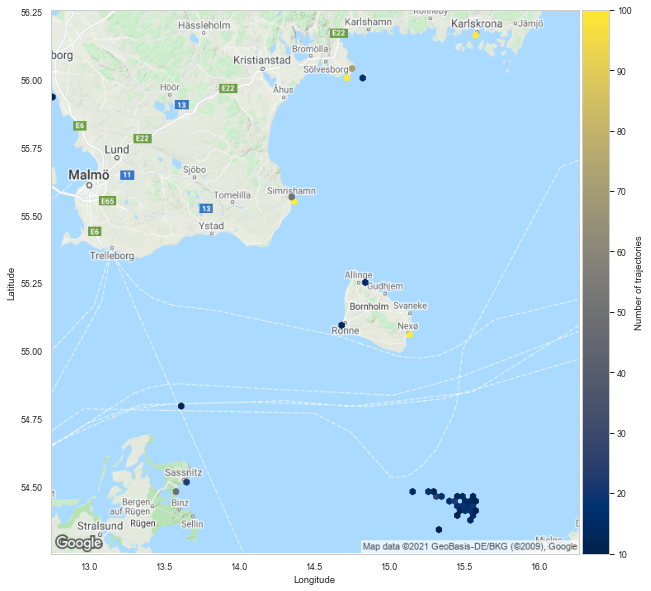

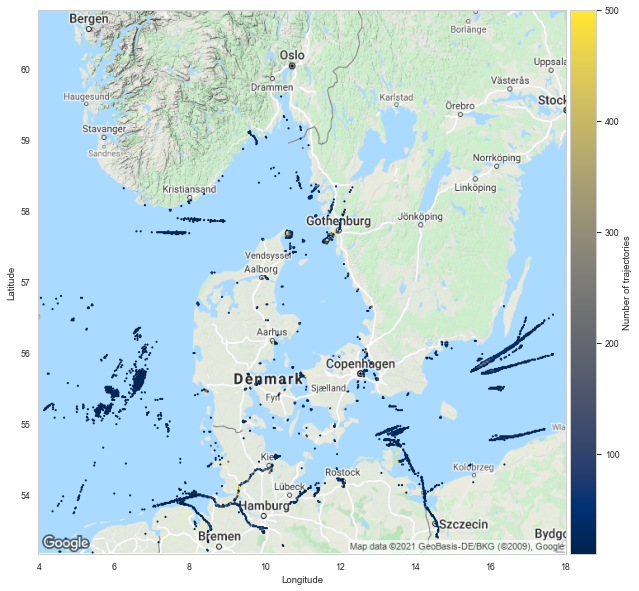

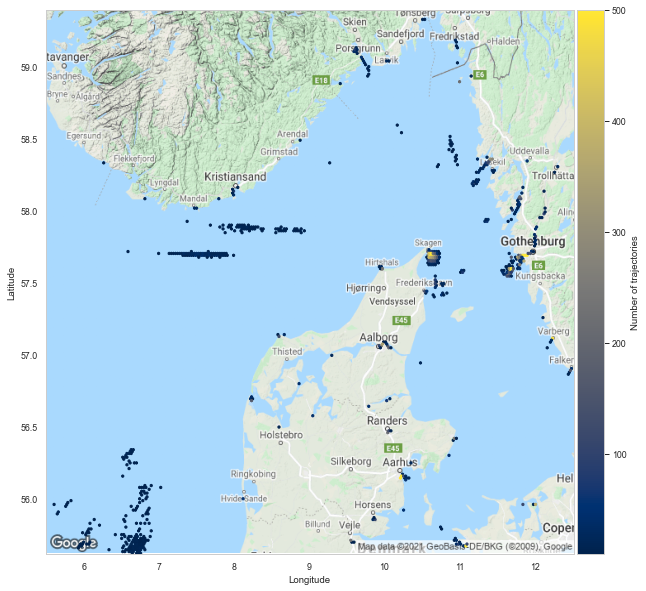

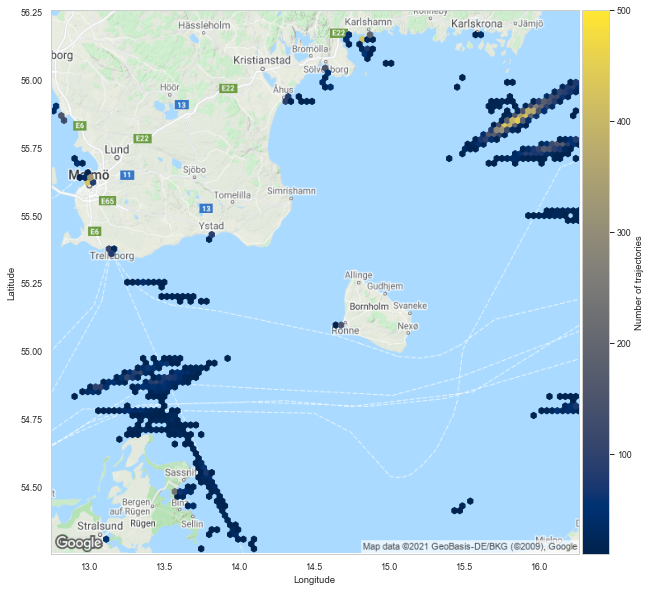

In [11]:
# Plot fishing trajectory starting locations on the static map - Heatmap
type = "Hex"
cb_label = "Number of trajectories"
vmax = 100
Denmark.plot_points(df_start_fishing_Denmark, type=type, x=x, y=y, bins=200, vmax=vmax, cb_label=cb_label)
Skagen.plot_points(df_start_fishing_Skagen, type=type, x=x, y=y, bins=100, vmax=vmax, cb_label=cb_label)
Bornholm.plot_points(df_start_fishing_Bornholm, type=type, x=x, y=y, bins=100, vmax=vmax, cb_label=cb_label)

# Plot tanker & cargo trajectory starting locations on the static map - Heatmap
vmax = 500
Denmark.plot_points(df_start_cargo_tank_Denmark, type=type, x=x, y=y, bins=500, vmax=vmax, cb_label=cb_label)
Skagen.plot_points(df_start_cargo_tank_Skagen, type=type, x=x, y=y, bins=250, vmax=vmax,cb_label=cb_label)
Bornholm.plot_points(df_start_cargo_tank_Bornholm, type=type, x=x, y=y, bins=100, vmax=vmax, cb_label=cb_label)

# End Location-Based Exploration

In [12]:
print(np.shape(df))
lat_lon_names = ["EndLat", "EndLon"]

# Take out points outside the min/max lon/lat interval - Denmark
df_end_Denmark = Denmark.remove_points_outside_ROI(df, lat_lon_names)
print(np.shape(df_end_Denmark))
    
# Take out points outside the min/max lon/lat interval - Skagen
df_end_Skagen = Skagen.remove_points_outside_ROI(df, lat_lon_names)
print(np.shape(df_end_Skagen))

# Take out points outside the min/max lon/lat interval - Bornholm
df_end_Bornholm = Bornholm.remove_points_outside_ROI(df, lat_lon_names)
print(np.shape(df_end_Bornholm))

(272589, 11)
(256516, 11)
(100131, 11)
(35529, 11)


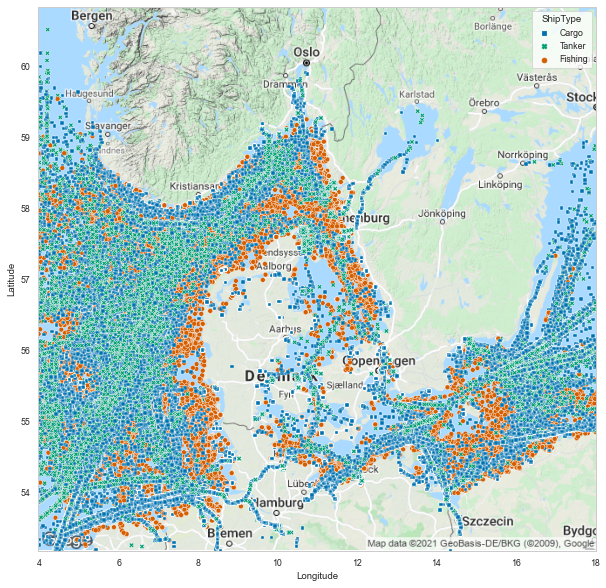

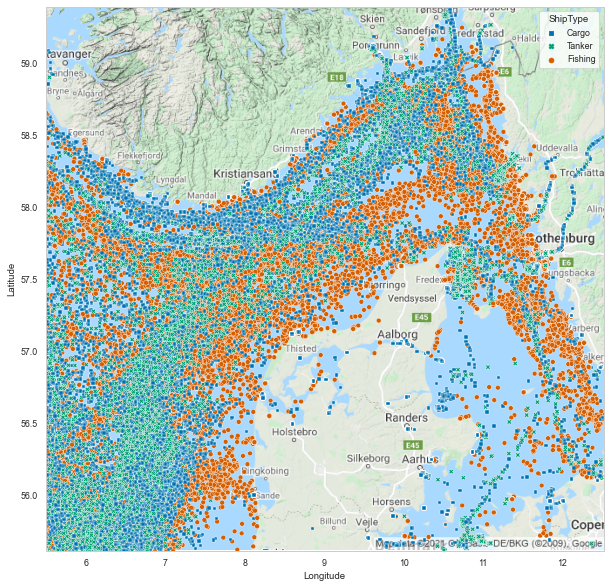

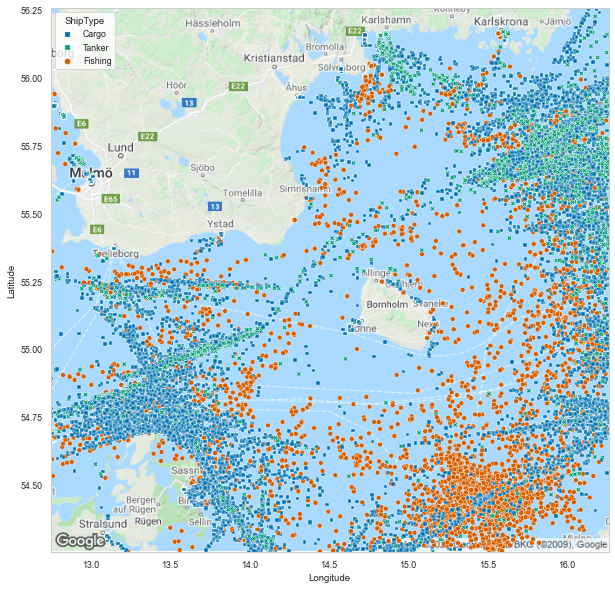

In [13]:
# Plot all the trajectory starting locations on the static map
type = "Scatter"
x = "EndLon"
y = "EndLat"
hue = "ShipType"
Denmark.plot_points(df_end_Denmark, type=type, x=x, y=y, hue=hue, style=hue, hue_order=hue_order)
Skagen.plot_points(df_end_Skagen, type=type, x=x, y=y, hue=hue, style=hue, hue_order=hue_order)
Bornholm.plot_points(df_end_Bornholm, type=type, x=x, y=y, hue=hue, style=hue, hue_order=hue_order)

In [14]:
# Define data frames that focus on fishing vessels
df_end_fishing_Denmark = df_end_Denmark.loc[df_end_Denmark["ShipType"] == "Fishing"]
print(np.shape(df_end_fishing_Denmark))
df_end_fishing_Skagen = df_end_Skagen.loc[df_end_Skagen["ShipType"] == "Fishing"]
print(np.shape(df_end_fishing_Skagen))
df_end_fishing_Bornholm = df_end_Bornholm.loc[df_end_Bornholm["ShipType"] == "Fishing"]
print(np.shape(df_end_fishing_Bornholm))
print()

# Define data frames that focus on cargo and tanker vessels
df_end_cargo_tank_Denmark = df_end_Denmark.loc[df_end_Denmark["ShipType"] != "Fishing"]
print(np.shape(df_end_cargo_tank_Denmark))
df_end_cargo_tank_Skagen = df_end_Skagen.loc[df_end_Skagen["ShipType"] != "Fishing"]
print(np.shape(df_end_cargo_tank_Skagen))
df_end_cargo_tank_Bornholm = df_end_Bornholm.loc[df_end_Bornholm["ShipType"] != "Fishing"]
print(np.shape(df_end_cargo_tank_Bornholm))

(60558, 11)
(34941, 11)
(5612, 11)

(195958, 11)
(65190, 11)
(29917, 11)


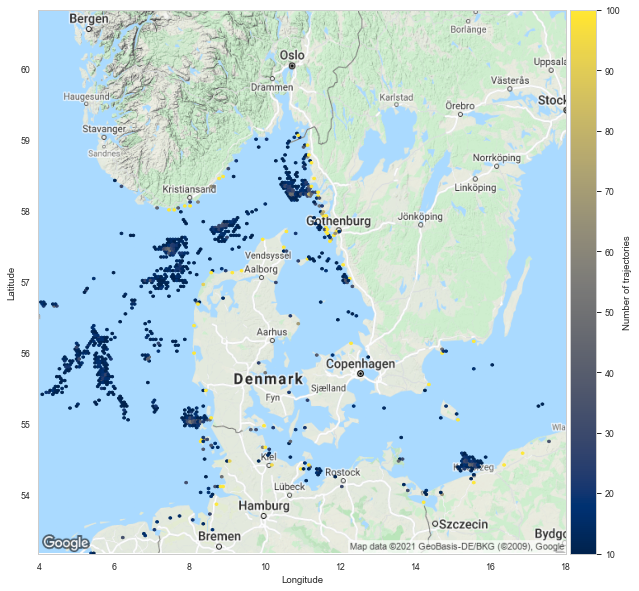

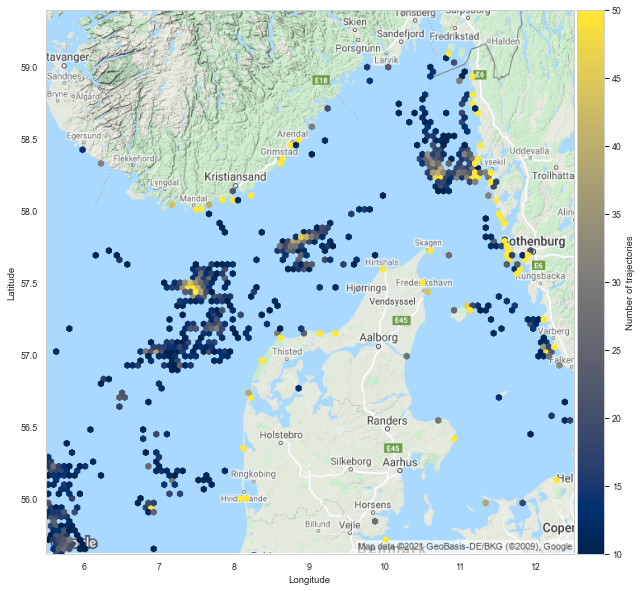

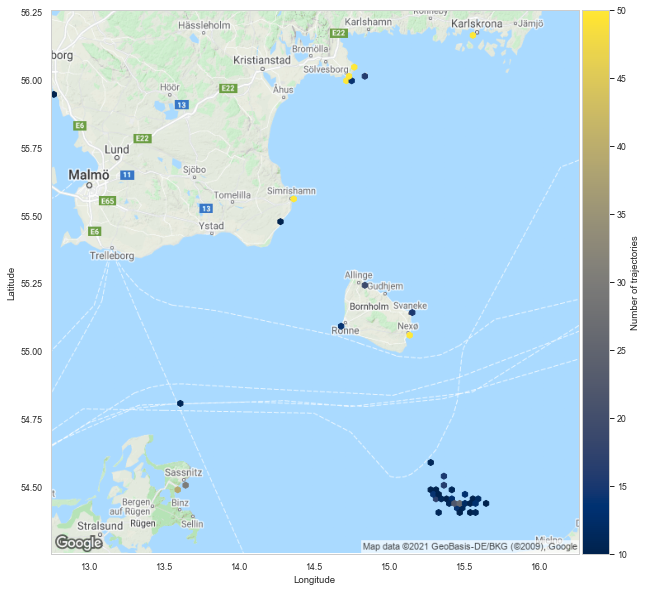

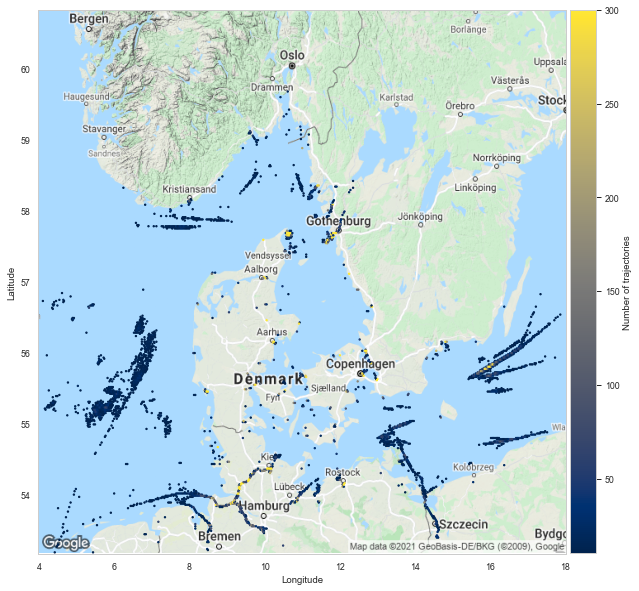

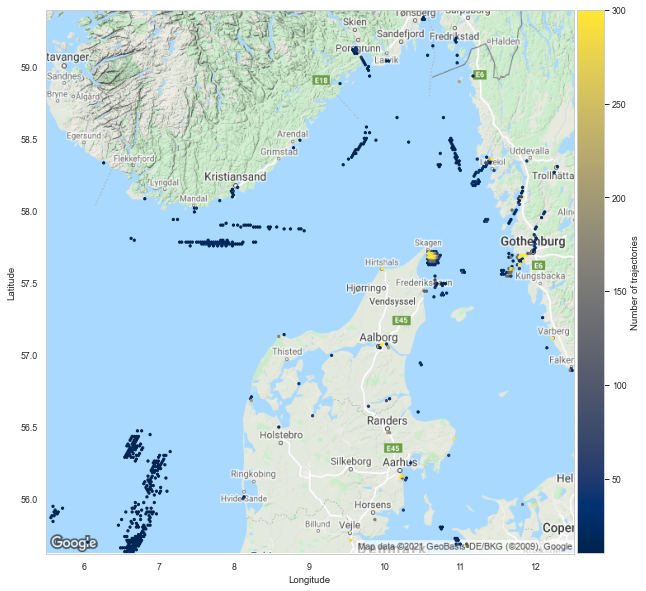

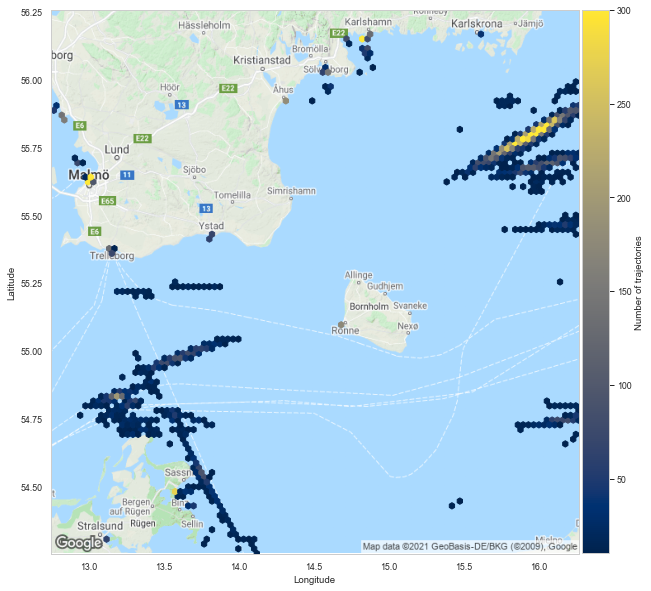

In [15]:
# Plot fishing trajectory starting locations on the static map - Heatmap
type = "Hex"
cb_label = "Number of trajectories"
Denmark.plot_points(df_end_fishing_Denmark, type=type, x=x, y=y, bins=200, vmax=100, cb_label=cb_label)
Skagen.plot_points(df_end_fishing_Skagen, type=type, x=x, y=y, bins=100, vmax=50, cb_label=cb_label)
Bornholm.plot_points(df_end_fishing_Bornholm, type=type, x=x, y=y, bins=100, vmax=50, cb_label=cb_label)

# Plot tanker & cargo trajectory starting locations on the static map - Heatmap
Denmark.plot_points(df_end_cargo_tank_Denmark, type=type, x=x, y=y, bins=400, vmax=300, cb_label=cb_label)
Skagen.plot_points(df_end_cargo_tank_Skagen, type=type, x=x, y=y, bins=250, vmax=300, cb_label=cb_label)
Bornholm.plot_points(df_end_cargo_tank_Bornholm, type=type, x=x, y=y, bins=100, vmax=300, cb_label=cb_label)